# Balance Stress Anomaly Detection 
Business Scenario
Detect transactions that excessively "stress" customer accounts:
- Large debits relative to account balance
- Deviations from normal spending patterns
- Potential overdraft or fraudulent activities 
Key Features to Engineer:
1. Amount_To_Balance_Ratio: Transaction amount / Current balance
2. Ratio_Flag: Binary flag if ratio > 1 (potential overdraw)
3. Trend_Deviation: Current ratio vs 6-month average ratio
4. Combined_Risk_Score: Integrated risk considering transaction count and type

In [2]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')

# Set visualization styles
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size'] = 12

# For better display
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)
pd.set_option('display.float_format', '{:.4f}'.format)

print("✅ Libraries imported successfully")

✅ Libraries imported successfully


In [5]:
# Load transaction data
try:
    # Try to load preprocessed data
    df = pd.read_csv('../data/processed/joined_table_preprocessed.csv')
    print(f"✅ Preprocessed data loaded! Shape: {df.shape}")
except FileNotFoundError:
    # Fallback to raw data
    df = pd.read_csv('../data/raw/joined_table.csv')
    print(f"✅ Raw data loaded! Shape: {df.shape}")

✅ Raw data loaded! Shape: (1304801, 15)


In [7]:
# %%
print("💳 TRANSACTION ANALYSIS")
print("="*60)

# %%
# Create Transaction_Date if not present
if 'Transaction_Date' not in df.columns:
    df['Transaction_Date'] = df['Last_Debit_Transaction_Date']
    print("Created Transaction_Date from Last_Debit_Transaction_Date")

💳 TRANSACTION ANALYSIS


In [10]:
# Display data information
print("\n📊 DATASET INFORMATION")
print("="*60)
print(f"Total records: {df.shape[0]:,}")
print(f"Total columns: {df.shape[1]}")

# Check required columns
required_cols = ['Current_Balance_LCY', 'Transaction_Amount', 'Debit_Credit_Flag', 'Transaction_Date']
missing_cols = [col for col in required_cols if col not in df.columns]

if missing_cols:
    print(f"❌ Missing required columns: {missing_cols}")
    print("Please ensure your dataset contains these columns.")
    raise KeyError(f"Missing columns: {missing_cols}")
else:
    print("✅ All required columns available")

print("\n📋 First 5 rows:")
display(df.head())


📊 DATASET INFORMATION
Total records: 1,304,801
Total columns: 16
✅ All required columns available

📋 First 5 rows:


,Account_Number,Customer_Branch_Code,End_of_Month,Current_Balance_LCY,Transaction_Amount,Last_Debit_Transaction_Date,Last_Credit_Transaction_Date,Transaction_Channel_Name,Total_Transaction_Count,Debit_Credit_Flag,Channel,Longitude,Latitude,Community,Region,Transaction_Date
0,2045317750241665,1,202501,1848748,515500.0000,2025-02-03 00:00:00.000,2025-01-31 00:00:00.000,MISTRALUSER,1.0000,D,RIDGE TOWER,5.5597,-0.2002,Accra,Greater Accra Region,2025-02-03 00:00:00.000
1,2045317750241665,1,202501,1848748,113410.0000,2025-02-03 00:00:00.000,2025-01-31 00:00:00.000,GAKRONG,1.0000,D,RIDGE TOWER,5.5597,-0.2002,Accra,Greater Accra Region,2025-02-03 00:00:00.000
2,2045317750241665,1,202501,1848748,29539181.0000,2025-02-03 00:00:00.000,2025-01-31 00:00:00.000,MOFFEI,1.0000,C,RIDGE TOWER,5.5597,-0.2002,Accra,Greater Accra Region,2025-02-03 00:00:00.000
3,2045317750241665,1,202501,1848748,343612.0000,2025-02-03 00:00:00.000,2025-01-31 00:00:00.000,ATMUSER,2.0000,D,RIDGE TOWER,5.5597,-0.2002,Accra,Greater Accra Region,2025-02-03 00:00:00.000
4,2045317750241665,1,202501,1848748,103100000.0000,2025-02-03 00:00:00.000,2025-01-31 00:00:00.000,AKUWORNU,1.0000,C,RIDGE TOWER,5.5597,-0.2002,Accra,Greater Accra Region,2025-02-03 00:00:00.000


In [11]:
# Check current column names
print("Current columns:", df.columns.tolist())

Current columns: ['Account_Number', 'Customer_Branch_Code', 'End_of_Month', 'Current_Balance_LCY', 'Transaction_Amount', 'Last_Debit_Transaction_Date', 'Last_Credit_Transaction_Date', 'Transaction_Channel_Name', 'Total_Transaction_Count', 'Debit_Credit_Flag', 'Channel', 'Longitude', 'Latitude', 'Community', 'Region', 'Transaction_Date']


In [12]:
# Data Preparation
print("🔄 PREPARING DATA FOR BALANCE STRESS ANALYSIS")
print("="*60)

# Convert data types
df['Transaction_Date'] = pd.to_datetime(df['Transaction_Date'], errors='coerce')
df['Current_Balance_LCY'] = pd.to_numeric(df['Current_Balance_LCY'], errors='coerce')
df['Transaction_Amount'] = pd.to_numeric(df['Transaction_Amount'], errors='coerce')

# Ensure we have Account_Number for customer-level analysis
if 'Account_Number' not in df.columns:
    print("⚠️ Account_Number not found. Creating customer IDs...")
    # Create synthetic customer IDs if not present
    df['Account_Number'] = df.index.astype(str)
    print(f"Created {df['Account_Number'].nunique():,} synthetic customer IDs")

print(f"✅ Data prepared. Unique customers: {df['Account_Number'].nunique():,}")

🔄 PREPARING DATA FOR BALANCE STRESS ANALYSIS
✅ Data prepared. Unique customers: 3,893


# 1.1 Calculate Balance Stress Features
Create features that measure how much a transaction "stresses" the account.

In [13]:
print("\n🔧 FEATURE ENGINEERING: BALANCE STRESS RATIOS")
print("="*60)

# 1. Calculate Amount to Balance Ratio
print("1. Calculating Amount_To_Balance_Ratio...")

# Handle zero or negative balances
df['Adjusted_Balance'] = df['Current_Balance_LCY'].copy()
df.loc[df['Adjusted_Balance'] <= 0, 'Adjusted_Balance'] = 1  # Avoid division by zero

# Calculate ratio
df['Amount_To_Balance_Ratio'] = df['Transaction_Amount'] / df['Adjusted_Balance']

print(f"   • Ratio range: [{df['Amount_To_Balance_Ratio'].min():.4f}, {df['Amount_To_Balance_Ratio'].max():.4f}]")
print(f"   • Mean ratio: {df['Amount_To_Balance_Ratio'].mean():.4f}")
print(f"   • Median ratio: {df['Amount_To_Balance_Ratio'].median():.4f}")

# 2. Create Ratio Flag (Binary indicator)
print("\n2. Creating Ratio_Flag...")

df['Ratio_Flag'] = (df['Amount_To_Balance_Ratio'] > 1).astype(int)

ratio_flag_count = df['Ratio_Flag'].sum()
ratio_flag_pct = ratio_flag_count / len(df) * 100

print(f"   • Transactions with ratio > 1: {ratio_flag_count:,} ({ratio_flag_pct:.2f}%)")
print(f"   • These transactions potentially exceed account balance")

# 3. Identify High-Stress Transactions
print("\n3. Identifying High-Stress Transactions...")

# Define stress levels
def categorize_stress_level(ratio):
    if ratio <= 0.1:
        return 'Low Stress'
    elif ratio <= 0.5:
        return 'Medium Stress'
    elif ratio <= 1.0:
        return 'High Stress'
    else:
        return 'Critical Stress'

df['Stress_Level'] = df['Amount_To_Balance_Ratio'].apply(categorize_stress_level)

# Display stress level distribution
stress_distribution = df['Stress_Level'].value_counts()
print("\n📊 Stress Level Distribution:")
for level, count in stress_distribution.items():
    pct = count / len(df) * 100
    print(f"   • {level:15s}: {count:8,} ({pct:5.1f}%)")

# 4. Analyze by Debit/Credit Type
print("\n4. Analyzing by Transaction Type...")

if 'Debit_Credit_Flag' in df.columns:
    stress_by_type = df.groupby(['Debit_Credit_Flag', 'Stress_Level']).size().unstack(fill_value=0)
    
    print("\n📊 Stress Levels by Transaction Type:")
    display(stress_by_type.style.background_gradient(cmap='YlOrRd'))
    
    # Calculate average ratio by type
    avg_ratio_by_type = df.groupby('Debit_Credit_Flag')['Amount_To_Balance_Ratio'].mean()
    print(f"\n💰 Average Ratio by Type:")
    for ttype, ratio in avg_ratio_by_type.items():
        print(f"   • {ttype}: {ratio:.4f}")


🔧 FEATURE ENGINEERING: BALANCE STRESS RATIOS
1. Calculating Amount_To_Balance_Ratio...
   • Ratio range: [-29206.7989, 3914090.0000]
   • Mean ratio: 704.5465
   • Median ratio: 0.0497

2. Creating Ratio_Flag...
   • Transactions with ratio > 1: 381,907 (29.27%)
   • These transactions potentially exceed account balance

3. Identifying High-Stress Transactions...

📊 Stress Level Distribution:
   • Low Stress     :  705,851 ( 54.1%)
   • Critical Stress:  387,330 ( 29.7%)
   • Medium Stress  :  140,502 ( 10.8%)
   • High Stress    :   71,118 (  5.5%)

4. Analyzing by Transaction Type...

📊 Stress Levels by Transaction Type:


Stress_Level,Critical Stress,High Stress,Low Stress,Medium Stress
Debit_Credit_Flag,,,,
C,171023,31117,443279,54981
D,210884,40001,262572,85521



💰 Average Ratio by Type:
   • C  : 653.3473
   • D  : 764.4151


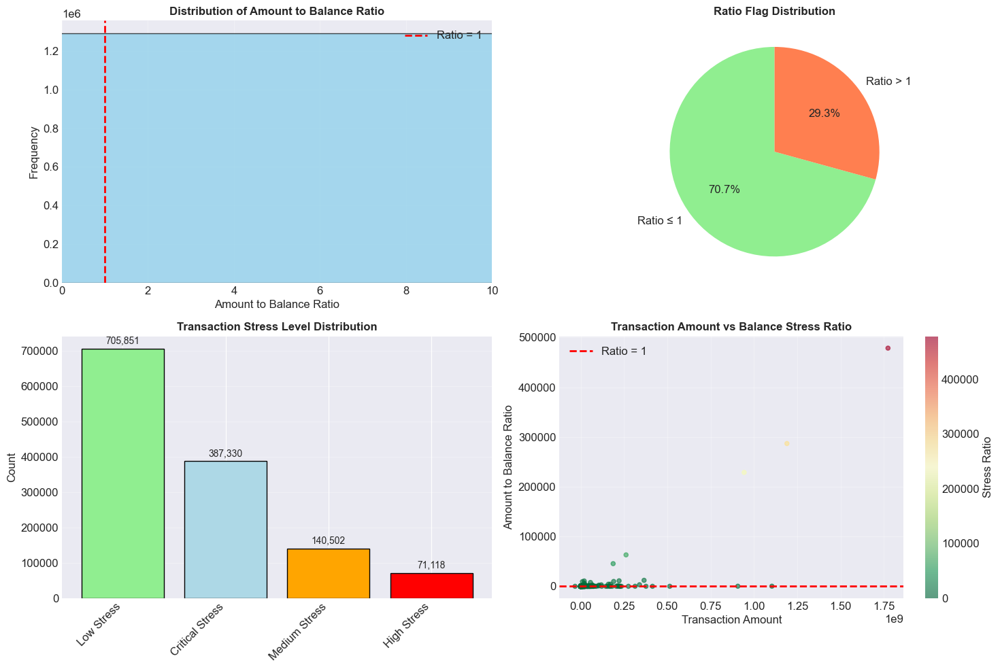

In [14]:
# Visualize Balance Stress Features
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Plot 1: Amount to Balance Ratio Distribution
axes[0,0].hist(df['Amount_To_Balance_Ratio'], bins=100, edgecolor='black', alpha=0.7, color='skyblue')
axes[0,0].set_xlabel('Amount to Balance Ratio')
axes[0,0].set_ylabel('Frequency')
axes[0,0].set_title('Distribution of Amount to Balance Ratio', fontsize=12, fontweight='bold')
axes[0,0].axvline(1, color='red', linestyle='--', linewidth=2, label='Ratio = 1')
axes[0,0].set_xlim([0, min(10, df['Amount_To_Balance_Ratio'].max())])  # Cap for visualization
axes[0,0].legend()
axes[0,0].grid(alpha=0.3)

# Plot 2: Ratio Flag Distribution
ratio_counts = df['Ratio_Flag'].value_counts()
colors = ['lightgreen', 'coral']
axes[0,1].pie(ratio_counts.values, labels=['Ratio ≤ 1', 'Ratio > 1'], 
              autopct='%1.1f%%', startangle=90, colors=colors)
axes[0,1].set_title('Ratio Flag Distribution', fontsize=12, fontweight='bold')

# Plot 3: Stress Level Distribution
stress_counts = df['Stress_Level'].value_counts()
colors = ['lightgreen', 'lightblue', 'orange', 'red']
axes[1,0].bar(range(len(stress_counts)), stress_counts.values, color=colors, edgecolor='black')
axes[1,0].set_xticks(range(len(stress_counts)))
axes[1,0].set_xticklabels(stress_counts.index, rotation=45, ha='right')
axes[1,0].set_ylabel('Count')
axes[1,0].set_title('Transaction Stress Level Distribution', fontsize=12, fontweight='bold')
axes[1,0].grid(alpha=0.3, axis='y')

# Add value labels
for i, count in enumerate(stress_counts.values):
    axes[1,0].text(i, count + max(stress_counts.values)*0.01, 
                   f'{count:,}', ha='center', va='bottom', fontsize=10)

# Plot 4: Ratio vs Transaction Amount
if len(df) > 1000:
    sample_df = df.sample(1000, random_state=42)  # Sample for visualization
else:
    sample_df = df

scatter = axes[1,1].scatter(sample_df['Transaction_Amount'], 
                           sample_df['Amount_To_Balance_Ratio'],
                           c=sample_df['Amount_To_Balance_Ratio'],
                           cmap='RdYlGn_r', alpha=0.6, s=20)
axes[1,1].set_xlabel('Transaction Amount')
axes[1,1].set_ylabel('Amount to Balance Ratio')
axes[1,1].set_title('Transaction Amount vs Balance Stress Ratio', fontsize=12, fontweight='bold')
axes[1,1].axhline(1, color='red', linestyle='--', linewidth=2, label='Ratio = 1')
axes[1,1].legend()
axes[1,1].grid(alpha=0.3)

plt.colorbar(scatter, ax=axes[1,1], label='Stress Ratio')
plt.tight_layout()
plt.show()

# 2.1 Calculate 6-Month Customer Trends
Analyze customer behavior over 6 months to establish baseline patterns.

In [17]:
print("\n📈 TREND ANALYSIS: 6-MONTH CUSTOMER BEHAVIOR")
print("="*60)

# Sort data by customer and date
df = df.sort_values(['Account_Number', 'Transaction_Date'])

# Calculate 6-month window for each transaction
print("Calculating 6-month rolling statistics for each customer...")

# We'll calculate for a sample if dataset is large
max_customers_for_trend = 10000
unique_customers = df['Account_Number'].nunique()

if unique_customers > max_customers_for_trend:
    print(f"⚠️ Large dataset ({unique_customers:,} customers). Calculating trends for sample...")
    sample_customers = df['Account_Number'].drop_duplicates().sample(max_customers_for_trend, random_state=42)
    df_trend = df[df['Account_Number'].isin(sample_customers)].copy()
else:
    df_trend = df.copy()

print(f"   • Customers for trend analysis: {df_trend['Account_Number'].nunique():,}")
print(f"   • Transactions for trend analysis: {len(df_trend):,}")

# Calculate 6-month average ratios per customer
print("\nCalculating 6-month average ratios...")

# Method 1: Simple moving average (faster)
df_trend['Transaction_Month'] = df_trend['Transaction_Date'].dt.to_period('M')

# Group by customer and month
monthly_stats = df_trend.groupby(['Account_Number', 'Transaction_Month']).agg({
    'Amount_To_Balance_Ratio': 'mean',
    'Transaction_Amount': ['count', 'sum'],
    'Current_Balance_LCY': 'mean'
}).reset_index()

# Flatten column names
monthly_stats.columns = ['Account_Number', 'Transaction_Month', 
                        'Avg_Monthly_Ratio', 'Transaction_Count', 
                        'Total_Amount', 'Avg_Balance']

# Calculate 6-month rolling average
def calculate_6month_avg(group):
    group = group.sort_values('Transaction_Month')
    group['SixMonth_Avg_Ratio'] = group['Avg_Monthly_Ratio'].rolling(window=6, min_periods=1).mean()
    return group

monthly_stats = monthly_stats.groupby('Account_Number', group_keys=False).apply(calculate_6month_avg)

print(f"✅ Calculated 6-month averages for {monthly_stats['Account_Number'].nunique():,} customers")

# Merge trend data back to transactions
print("\nMerging trend data with transactions...")

# Convert period to datetime for easier comparison if needed
monthly_stats['Month_Start'] = monthly_stats['Transaction_Month'].dt.to_timestamp()

# Create a function to find the most recent 6-month average for each transaction
def get_trend_data(row):
    customer_data = monthly_stats[monthly_stats['Account_Number'] == row['Account_Number']]
    
    # Find monthly data for the transaction's month
    trans_month = row['Transaction_Date'].to_period('M')
    
    # FIXED: Changed 'customer_stats' to 'customer_data'
    month_data = customer_data[customer_data['Transaction_Month'] == trans_month]
    
    if not month_data.empty:
        return pd.Series({
            'SixMonth_Avg_Ratio': month_data['SixMonth_Avg_Ratio'].iloc[0],
            'Avg_Monthly_Ratio': month_data['Avg_Monthly_Ratio'].iloc[0],
            'Monthly_Transaction_Count': month_data['Transaction_Count'].iloc[0]
        })
    else:
        # Use overall customer average or NaN if no data
        if not customer_data.empty:
            overall_avg = customer_data['Avg_Monthly_Ratio'].mean()
            avg_count = customer_data['Transaction_Count'].mean()
        else:
            overall_avg = np.nan
            avg_count = np.nan
            
        return pd.Series({
            'SixMonth_Avg_Ratio': overall_avg,
            'Avg_Monthly_Ratio': overall_avg,
            'Monthly_Transaction_Count': avg_count
        })

# Apply to a sample for performance
sample_size = min(50000, len(df))
df_sample = df.head(sample_size).copy()

print(f"Applying trend calculation to {sample_size:,} transaction sample...")

# Make sure you have numpy imported
import numpy as np

trend_data = df_sample.apply(get_trend_data, axis=1)
df_sample = pd.concat([df_sample, trend_data], axis=1)

print("✅ Trend data merged")
print(f"\n📊 Sample Data with Trends (first 5 rows):")
print(df_sample[['Account_Number', 'Transaction_Date', 'Transaction_Amount', 
                 'SixMonth_Avg_Ratio', 'Avg_Monthly_Ratio']].head())


📈 TREND ANALYSIS: 6-MONTH CUSTOMER BEHAVIOR
Calculating 6-month rolling statistics for each customer...
   • Customers for trend analysis: 3,893
   • Transactions for trend analysis: 1,304,801

Calculating 6-month average ratios...
✅ Calculated 6-month averages for 3,893 customers

Merging trend data with transactions...
Applying trend calculation to 50,000 transaction sample...
✅ Trend data merged

📊 Sample Data with Trends (first 5 rows):
     Account_Number Transaction_Date  Transaction_Amount  SixMonth_Avg_Ratio  \
0  2045317750241665       2025-02-03         515500.0000              8.6922   
1  2045317750241665       2025-02-03         113410.0000              8.6922   
2  2045317750241665       2025-02-03       29539181.0000              8.6922   
3  2045317750241665       2025-02-03         343612.0000              8.6922   
4  2045317750241665       2025-02-03      103100000.0000              8.6922   

   Avg_Monthly_Ratio  
0             8.6922  
1             8.6922  
2   

In [18]:
# Calculate Trend Deviation
print("\nCalculating Trend Deviation...")

# Avoid division by zero
df_sample['Adjusted_SixMonth_Avg'] = df_sample['SixMonth_Avg_Ratio'].replace(0, np.nan)

# Calculate deviation from trend
df_sample['Trend_Deviation_Ratio'] = df_sample['Amount_To_Balance_Ratio'] / df_sample['Adjusted_SixMonth_Avg']

# Flag significant deviations
deviation_threshold = 2.0  # 2x the average
df_sample['Trend_Deviation_Flag'] = (df_sample['Trend_Deviation_Ratio'] > deviation_threshold).astype(int)

# Handle cases where we don't have trend data
df_sample['Trend_Deviation_Flag'] = df_sample['Trend_Deviation_Flag'].fillna(0)

print(f"✅ Trend deviation calculated (threshold: {deviation_threshold}x)")
print(f"   • Transactions with significant deviation: {df_sample['Trend_Deviation_Flag'].sum():,}")
print(f"   • Deviation rate: {df_sample['Trend_Deviation_Flag'].sum()/len(df_sample)*100:.2f}%")

# %%
# Analyze trend deviation patterns
print("\n📊 Trend Deviation Analysis:")

if 'Debit_Credit_Flag' in df_sample.columns:
    deviation_by_type = df_sample.groupby('Debit_Credit_Flag')['Trend_Deviation_Flag'].mean() * 100
    for ttype, pct in deviation_by_type.items():
        print(f"   • {ttype}: {pct:.1f}% of transactions show significant deviation")

# Analyze by stress level
deviation_by_stress = df_sample.groupby('Stress_Level')['Trend_Deviation_Flag'].mean() * 100
for level, pct in deviation_by_stress.items():
    print(f"   • {level}: {pct:.1f}% show significant deviation")


Calculating Trend Deviation...
✅ Trend deviation calculated (threshold: 2.0x)
   • Transactions with significant deviation: 6,006
   • Deviation rate: 12.01%

📊 Trend Deviation Analysis:
   • C  : 15.8% of transactions show significant deviation
   • D  : 9.7% of transactions show significant deviation
   • Critical Stress: 28.5% show significant deviation
   • High Stress: 8.8% show significant deviation
   • Low Stress: 0.9% show significant deviation
   • Medium Stress: 5.9% show significant deviation


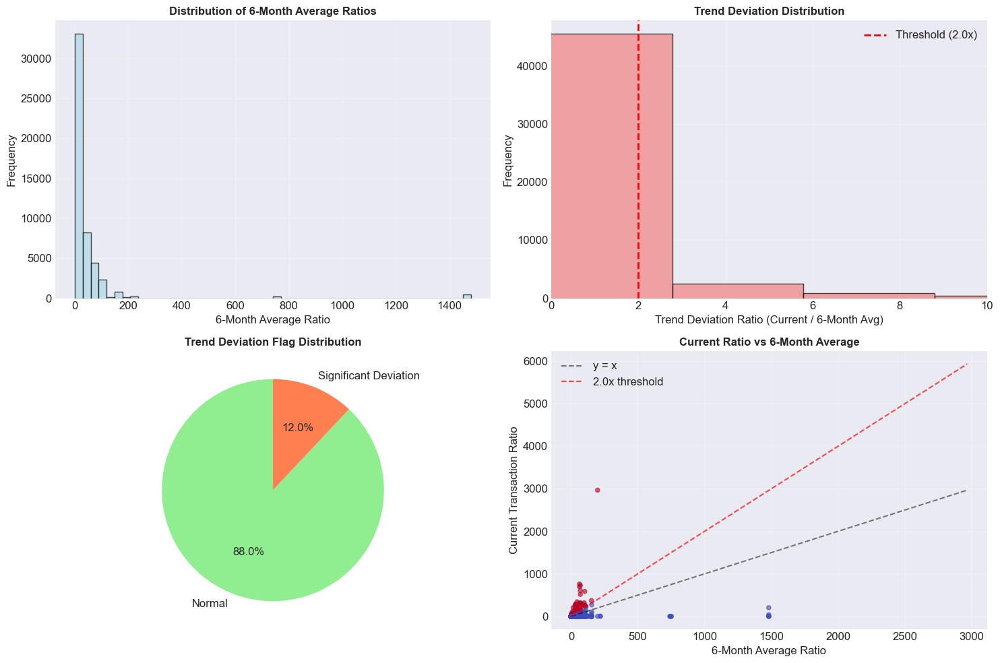

In [19]:
# Visualize Trend Analysis
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Plot 1: 6-Month Average Ratio Distribution
if 'SixMonth_Avg_Ratio' in df_sample.columns:
    valid_ratios = df_sample['SixMonth_Avg_Ratio'].dropna()
    axes[0,0].hist(valid_ratios, bins=50, edgecolor='black', alpha=0.7, color='lightblue')
    axes[0,0].set_xlabel('6-Month Average Ratio')
    axes[0,0].set_ylabel('Frequency')
    axes[0,0].set_title('Distribution of 6-Month Average Ratios', fontsize=12, fontweight='bold')
    axes[0,0].grid(alpha=0.3)

# Plot 2: Trend Deviation Ratio Distribution
if 'Trend_Deviation_Ratio' in df_sample.columns:
    valid_deviations = df_sample['Trend_Deviation_Ratio'].dropna()
    axes[0,1].hist(valid_deviations, bins=50, edgecolor='black', alpha=0.7, color='lightcoral')
    axes[0,1].axvline(deviation_threshold, color='red', linestyle='--', linewidth=2, 
                     label=f'Threshold ({deviation_threshold}x)')
    axes[0,1].set_xlabel('Trend Deviation Ratio (Current / 6-Month Avg)')
    axes[0,1].set_ylabel('Frequency')
    axes[0,1].set_title('Trend Deviation Distribution', fontsize=12, fontweight='bold')
    axes[0,1].legend()
    axes[0,1].grid(alpha=0.3)
    axes[0,1].set_xlim([0, min(10, valid_deviations.max())])

# Plot 3: Trend Deviation Flag Distribution
if 'Trend_Deviation_Flag' in df_sample.columns:
    deviation_counts = df_sample['Trend_Deviation_Flag'].value_counts()
    colors = ['lightgreen', 'coral']
    axes[1,0].pie(deviation_counts.values, labels=['Normal', 'Significant Deviation'], 
                  autopct='%1.1f%%', startangle=90, colors=colors)
    axes[1,0].set_title('Trend Deviation Flag Distribution', fontsize=12, fontweight='bold')

# Plot 4: Current Ratio vs 6-Month Average (Scatter)
if all(col in df_sample.columns for col in ['Amount_To_Balance_Ratio', 'SixMonth_Avg_Ratio']):
    sample_points = min(1000, len(df_sample))
    scatter_sample = df_sample.dropna(subset=['Amount_To_Balance_Ratio', 'SixMonth_Avg_Ratio']).sample(sample_points, random_state=42)
    
    axes[1,1].scatter(scatter_sample['SixMonth_Avg_Ratio'], 
                     scatter_sample['Amount_To_Balance_Ratio'],
                     c=scatter_sample['Trend_Deviation_Flag'],
                     cmap='coolwarm', alpha=0.6, s=20)
    
    # Add identity line
    max_val = max(scatter_sample['SixMonth_Avg_Ratio'].max(), 
                 scatter_sample['Amount_To_Balance_Ratio'].max())
    axes[1,1].plot([0, max_val], [0, max_val], 'k--', alpha=0.5, label='y = x')
    
    # Add threshold lines
    x = np.linspace(0, max_val, 100)
    axes[1,1].plot(x, deviation_threshold * x, 'r--', alpha=0.7, 
                  label=f'{deviation_threshold}x threshold')
    
    axes[1,1].set_xlabel('6-Month Average Ratio')
    axes[1,1].set_ylabel('Current Transaction Ratio')
    axes[1,1].set_title('Current Ratio vs 6-Month Average', fontsize=12, fontweight='bold')
    axes[1,1].legend()
    axes[1,1].grid(alpha=0.3)

plt.tight_layout()
plt.show()

# 3.1 Create Combined Risk Score
Implement the combined risk scoring formula:
ratio_amount_score = ratio * TOT_COUNT * (1 if DRCR='D' else 0)

In [20]:
print("\n⚠️ COMBINED RISK SCORING")
print("="*60)

# %%
# Prepare data for risk scoring
print("Preparing data for combined risk scoring...")

# Ensure we have required columns
if 'Total_Transaction_Count' not in df.columns:
    print("⚠️ Total_Transaction_Count not found. Calculating from data...")
    
    # Calculate transaction count per customer
    transaction_counts = df.groupby('Account_Number').size().reset_index(name='Total_Transaction_Count')
    df = df.merge(transaction_counts, on='Account_Number', how='left')
    print(f"   • Calculated transaction counts for {df['Account_Number'].nunique():,} customers")

# Create Debit Indicator
print("Creating debit indicator...")
df['Debit_Indicator'] = (df['Debit_Credit_Flag'] == 'D').astype(int)

print(f"   • Debit transactions: {df['Debit_Indicator'].sum():,}")
print(f"   • Credit transactions: {(df['Debit_Indicator'] == 0).sum():,}")

# %%
# Calculate Combined Risk Score
print("\nCalculating Combined Risk Score...")

# Base formula: ratio * transaction_count * debit_indicator
df['Combined_Risk_Score'] = (
    df['Amount_To_Balance_Ratio'] * 
    df['Total_Transaction_Count'] * 
    df['Debit_Indicator']
)

print(f"✅ Combined risk score calculated")
print(f"   • Score range: [{df['Combined_Risk_Score'].min():.4f}, {df['Combined_Risk_Score'].max():.4f}]")
print(f"   • Mean score: {df['Combined_Risk_Score'].mean():.4f}")
print(f"   • Median score: {df['Combined_Risk_Score'].median():.4f}")

# %%
# Enhanced Risk Scoring with Trend Deviation
print("\nCalculating Enhanced Risk Score...")

# Include trend deviation in risk scoring
df['Trend_Deviation_Factor'] = df_sample['Trend_Deviation_Ratio'].fillna(1)  # Default to 1 if no trend data

# Enhanced formula: (ratio * deviation_factor) * transaction_count * debit_indicator
df['Enhanced_Risk_Score'] = (
    df['Amount_To_Balance_Ratio'] * 
    df['Trend_Deviation_Factor'].clip(upper=10) *  # Cap extreme deviations
    df['Total_Transaction_Count'] * 
    df['Debit_Indicator']
)

print(f"✅ Enhanced risk score calculated (with trend deviation)")
print(f"   • Score range: [{df['Enhanced_Risk_Score'].min():.4f}, {df['Enhanced_Risk_Score'].max():.4f}]")

# %%
# Create Risk Categories
print("\nCreating Risk Categories...")

def categorize_risk(score):
    if score == 0:
        return 'No Risk'
    elif score <= 1:
        return 'Low Risk'
    elif score <= 5:
        return 'Medium Risk'
    elif score <= 20:
        return 'High Risk'
    else:
        return 'Critical Risk'

df['Risk_Category'] = df['Enhanced_Risk_Score'].apply(categorize_risk)

# Display risk distribution
risk_distribution = df['Risk_Category'].value_counts()
print("\n📊 Risk Category Distribution:")
for category, count in risk_distribution.items():
    pct = count / len(df) * 100
    print(f"   • {category:12s}: {count:8,} ({pct:5.1f}%)")

# %%
# Analyze High-Risk Transactions
print("\n🔍 Analyzing High-Risk Transactions...")

high_risk_mask = df['Risk_Category'].isin(['High Risk', 'Critical Risk'])
high_risk_df = df[high_risk_mask].copy()

print(f"📊 High/Critical Risk Transactions: {len(high_risk_df):,}")

if len(high_risk_df) > 0:
    print("\n📈 Characteristics of High-Risk Transactions:")
    
    # Average metrics
    avg_ratio = high_risk_df['Amount_To_Balance_Ratio'].mean()
    avg_amount = high_risk_df['Transaction_Amount'].mean()
    avg_balance = high_risk_df['Current_Balance_LCY'].mean()
    
    print(f"   • Average Ratio: {avg_ratio:.3f}")
    print(f"   • Average Amount: {avg_amount:,.0f}")
    print(f"   • Average Balance: {avg_balance:,.0f}")
    
    # By transaction type
    if 'Debit_Credit_Flag' in high_risk_df.columns:
        type_dist = high_risk_df['Debit_Credit_Flag'].value_counts()
        for ttype, count in type_dist.items():
            pct = count / len(high_risk_df) * 100
            print(f"   • {ttype}: {count:,} ({pct:.1f}%)")
    
    # Top customers by risk
    top_risky_customers = high_risk_df.groupby('Account_Number')['Enhanced_Risk_Score'].max().nlargest(5)
    print(f"\n🏆 Top 5 Riskiest Customers:")
    for account, score in top_risky_customers.items():
        customer_data = high_risk_df[high_risk_df['Account_Number'] == account].iloc[0]
        print(f"   • Account: {account}")
        print(f"     - Max Risk Score: {score:.2f}")
        print(f"     - Transaction Count: {customer_data['Total_Transaction_Count']}")
        print(f"     - Latest Ratio: {customer_data['Amount_To_Balance_Ratio']:.3f}")


⚠️ COMBINED RISK SCORING
Preparing data for combined risk scoring...
Creating debit indicator...
   • Debit transactions: 0
   • Credit transactions: 1,304,801

Calculating Combined Risk Score...
✅ Combined risk score calculated
   • Score range: [0.0000, 0.0000]
   • Mean score: 0.0000
   • Median score: 0.0000

Calculating Enhanced Risk Score...
✅ Enhanced risk score calculated (with trend deviation)
   • Score range: [0.0000, 0.0000]

Creating Risk Categories...

📊 Risk Category Distribution:
   • Critical Risk: 1,254,833 ( 96.2%)
   • No Risk     :   49,968 (  3.8%)

🔍 Analyzing High-Risk Transactions...
📊 High/Critical Risk Transactions: 1,254,833

📈 Characteristics of High-Risk Transactions:
   • Average Ratio: 731.051
   • Average Amount: 12,140,315
   • Average Balance: 17,643,842
   • C  : 681,290 (54.3%)
   • D  : 568,120 (45.3%)

🏆 Top 5 Riskiest Customers:
   • Account: 2126637697009765
     - Max Risk Score: nan
     - Transaction Count: nan
     - Latest Ratio: nan
   • 

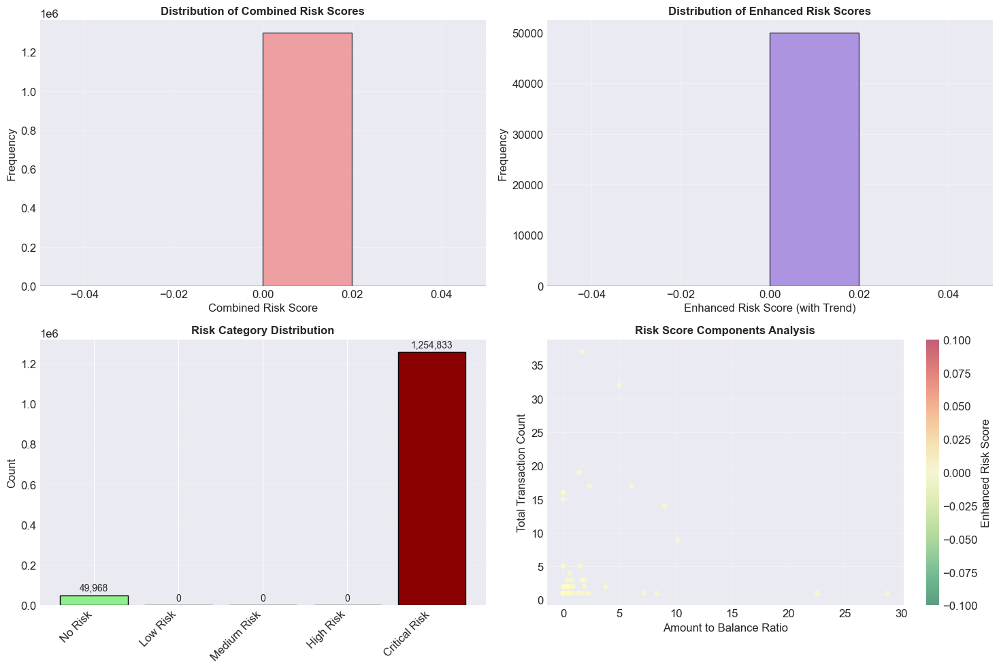

In [21]:
# Visualize Risk Scoring Results
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Plot 1: Combined Risk Score Distribution
axes[0,0].hist(df['Combined_Risk_Score'], bins=50, edgecolor='black', alpha=0.7, color='lightcoral')
axes[0,0].set_xlabel('Combined Risk Score')
axes[0,0].set_ylabel('Frequency')
axes[0,0].set_title('Distribution of Combined Risk Scores', fontsize=12, fontweight='bold')
axes[0,0].set_xlim([0, min(50, df['Combined_Risk_Score'].max())])
axes[0,0].grid(alpha=0.3)

# Plot 2: Enhanced Risk Score Distribution
axes[0,1].hist(df['Enhanced_Risk_Score'], bins=50, edgecolor='black', alpha=0.7, color='mediumpurple')
axes[0,1].set_xlabel('Enhanced Risk Score (with Trend)')
axes[0,1].set_ylabel('Frequency')
axes[0,1].set_title('Distribution of Enhanced Risk Scores', fontsize=12, fontweight='bold')
axes[0,1].set_xlim([0, min(100, df['Enhanced_Risk_Score'].max())])
axes[0,1].grid(alpha=0.3)

# Plot 3: Risk Category Distribution
risk_counts = df['Risk_Category'].value_counts()
colors = ['lightgreen', 'lightblue', 'orange', 'red', 'darkred']
category_order = ['No Risk', 'Low Risk', 'Medium Risk', 'High Risk', 'Critical Risk']

# Reorder based on defined order
risk_counts = risk_counts.reindex(category_order, fill_value=0)

bars = axes[1,0].bar(range(len(risk_counts)), risk_counts.values, color=colors, edgecolor='black')
axes[1,0].set_xticks(range(len(risk_counts)))
axes[1,0].set_xticklabels(risk_counts.index, rotation=45, ha='right')
axes[1,0].set_ylabel('Count')
axes[1,0].set_title('Risk Category Distribution', fontsize=12, fontweight='bold')
axes[1,0].grid(alpha=0.3, axis='y')

# Add value labels
for i, (bar, count) in enumerate(zip(bars, risk_counts.values)):
    axes[1,0].text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(risk_counts.values)*0.01,
                  f'{count:,}', ha='center', va='bottom', fontsize=10)

# Plot 4: Risk Score Components Analysis
sample_size = min(1000, len(df))
sample_df = df.sample(sample_size, random_state=42)

scatter = axes[1,1].scatter(sample_df['Amount_To_Balance_Ratio'], 
                           sample_df['Total_Transaction_Count'],
                           c=sample_df['Enhanced_Risk_Score'],
                           cmap='RdYlGn_r', alpha=0.6, s=20)
axes[1,1].set_xlabel('Amount to Balance Ratio')
axes[1,1].set_ylabel('Total Transaction Count')
axes[1,1].set_title('Risk Score Components Analysis', fontsize=12, fontweight='bold')
axes[1,1].grid(alpha=0.3)

plt.colorbar(scatter, ax=axes[1,1], label='Enhanced Risk Score')
plt.tight_layout()
plt.show()

# 4.1 Create Anomaly Detection System
Combine all features to create a comprehensive anomaly detection system.

In [22]:
print("\n🚨 ANOMALY DETECTION SYSTEM")
print("="*60)

# %%
# Create Anomaly Flags
print("Creating comprehensive anomaly flags...")

# Flag 1: High Balance Stress (Ratio > 1)
df['Anomaly_Flag_HighStress'] = df['Ratio_Flag']

# Flag 2: Significant Trend Deviation
df['Anomaly_Flag_TrendDev'] = df_sample['Trend_Deviation_Flag'].fillna(0)

# Flag 3: High Combined Risk
risk_threshold = df['Enhanced_Risk_Score'].quantile(0.95)  # Top 5%
df['Anomaly_Flag_HighRisk'] = (df['Enhanced_Risk_Score'] > risk_threshold).astype(int)

# Combined Anomaly Flag (any of the above)
df['Anomaly_Flag_Combined'] = (
    (df['Anomaly_Flag_HighStress'] == 1) |
    (df['Anomaly_Flag_TrendDev'] == 1) |
    (df['Anomaly_Flag_HighRisk'] == 1)
).astype(int)

print(f"✅ Anomaly flags created")
print(f"   • High Stress anomalies: {df['Anomaly_Flag_HighStress'].sum():,}")
print(f"   • Trend Deviation anomalies: {df['Anomaly_Flag_TrendDev'].sum():,}")
print(f"   • High Risk anomalies (top 5%): {df['Anomaly_Flag_HighRisk'].sum():,}")
print(f"   • Combined anomalies (any flag): {df['Anomaly_Flag_Combined'].sum():,}")

# %%
# Create Anomaly Severity Score
print("\nCalculating Anomaly Severity Score...")

# Weighted combination of anomaly indicators
df['Anomaly_Severity_Score'] = (
    df['Anomaly_Flag_HighStress'] * 0.4 +          # 40% weight for high stress
    df['Anomaly_Flag_TrendDev'] * 0.3 +           # 30% weight for trend deviation
    df['Anomaly_Flag_HighRisk'] * 0.3 +           # 30% weight for high risk
    (df['Stress_Level'] == 'Critical Stress').astype(int) * 0.2  # Bonus for critical stress
).clip(upper=1.0)  # Cap at 1.0

print(f"✅ Anomaly severity scores calculated")
print(f"   • Score range: [{df['Anomaly_Severity_Score'].min():.3f}, {df['Anomaly_Severity_Score'].max():.3f}]")
print(f"   • Mean severity: {df['Anomaly_Severity_Score'].mean():.3f}")

# %%
# Create Alert Priority Levels
print("\nCreating Alert Priority Levels...")

def determine_alert_priority(row):
    severity = row['Anomaly_Severity_Score']
    risk_category = row['Risk_Category']
    
    # Critical: Multiple high-risk indicators
    if (severity >= 0.8) or (risk_category == 'Critical Risk'):
        return 'CRITICAL'
    # High: Single high-risk indicator or multiple medium-risk
    elif (severity >= 0.6) or (risk_category == 'High Risk'):
        return 'HIGH'
    # Medium: Medium risk with some anomaly indicators
    elif (severity >= 0.4) or (risk_category == 'Medium Risk'):
        return 'MEDIUM'
    # Low: Low risk or informational
    elif severity > 0:
        return 'LOW'
    else:
        return 'NONE'

df['Alert_Priority'] = df.apply(determine_alert_priority, axis=1)

# Display alert distribution
alert_distribution = df['Alert_Priority'].value_counts()
print("\n📊 Alert Priority Distribution:")
for priority, count in alert_distribution.items():
    pct = count / len(df) * 100
    print(f"   • {priority:8s}: {count:8,} ({pct:5.1f}%)")

# %%
# Create Investigation-Ready Output
print("\nCreating investigation-ready output...")

# Select high-priority alerts for investigation
high_priority_alerts = df[df['Alert_Priority'].isin(['CRITICAL', 'HIGH'])].copy()

# Sort by severity and risk score
high_priority_alerts = high_priority_alerts.sort_values(
    ['Anomaly_Severity_Score', 'Enhanced_Risk_Score'], 
    ascending=[False, False]
)

print(f"📊 High Priority Alerts for Investigation: {len(high_priority_alerts):,}")

if len(high_priority_alerts) > 0:
    print("\n🔍 Top 10 High-Priority Alerts:")
    
    # Create summary view
    alert_summary = high_priority_alerts.head(10)[[
        'Account_Number', 'Transaction_Date', 'Transaction_Amount',
        'Current_Balance_LCY', 'Amount_To_Balance_Ratio',
        'Stress_Level', 'Risk_Category', 'Alert_Priority',
        'Anomaly_Severity_Score', 'Enhanced_Risk_Score'
    ]]
    
    display(alert_summary.style.background_gradient(subset=['Anomaly_Severity_Score'], cmap='Reds'))


🚨 ANOMALY DETECTION SYSTEM
Creating comprehensive anomaly flags...
✅ Anomaly flags created
   • High Stress anomalies: 381,907
   • Trend Deviation anomalies: 6,006.0
   • High Risk anomalies (top 5%): 0
   • Combined anomalies (any flag): 382,987

Calculating Anomaly Severity Score...
✅ Anomaly severity scores calculated
   • Score range: [0.000, 0.900]
   • Mean severity: 0.243

Creating Alert Priority Levels...

📊 Alert Priority Distribution:
   • CRITICAL: 1,259,759 ( 96.5%)
   • NONE    :   31,638 (  2.4%)
   • HIGH    :   12,324 (  0.9%)
   • LOW     :    1,080 (  0.1%)

Creating investigation-ready output...
📊 High Priority Alerts for Investigation: 1,272,083

🔍 Top 10 High-Priority Alerts:


,Account_Number,Transaction_Date,Transaction_Amount,Current_Balance_LCY,Amount_To_Balance_Ratio,Stress_Level,Risk_Category,Alert_Priority,Anomaly_Severity_Score,Enhanced_Risk_Score
4,2045317750241665,2025-02-03 00:00:00,103100000.000000,1848748,55.767471,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
34,2045317750241665,2025-02-03 00:00:00,33057767.000000,1848748,17.881164,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
49,2045317750241665,2025-02-03 00:00:00,33057767.000000,1848748,17.881164,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
63,2045317750241665,2025-02-03 00:00:00,51314159.000000,1848748,27.756167,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
65,2045317750241665,2025-02-03 00:00:00,92377600.000000,1848748,49.967654,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
66,2045317750241665,2025-02-03 00:00:00,42528750.000000,1848748,23.004082,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
87,2045317750241665,2025-02-03 00:00:00,37116000.000000,1848748,20.076289,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
88,2045317750241665,2025-02-03 00:00:00,77706470.000000,1848748,42.031943,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
93,2045317750241665,2025-02-03 00:00:00,68395509.000000,1848748,36.995582,Critical Stress,No Risk,CRITICAL,0.900000,0.000000
94,2045317750241665,2025-02-03 00:00:00,68038783.000000,1848748,36.802627,Critical Stress,No Risk,CRITICAL,0.900000,0.000000


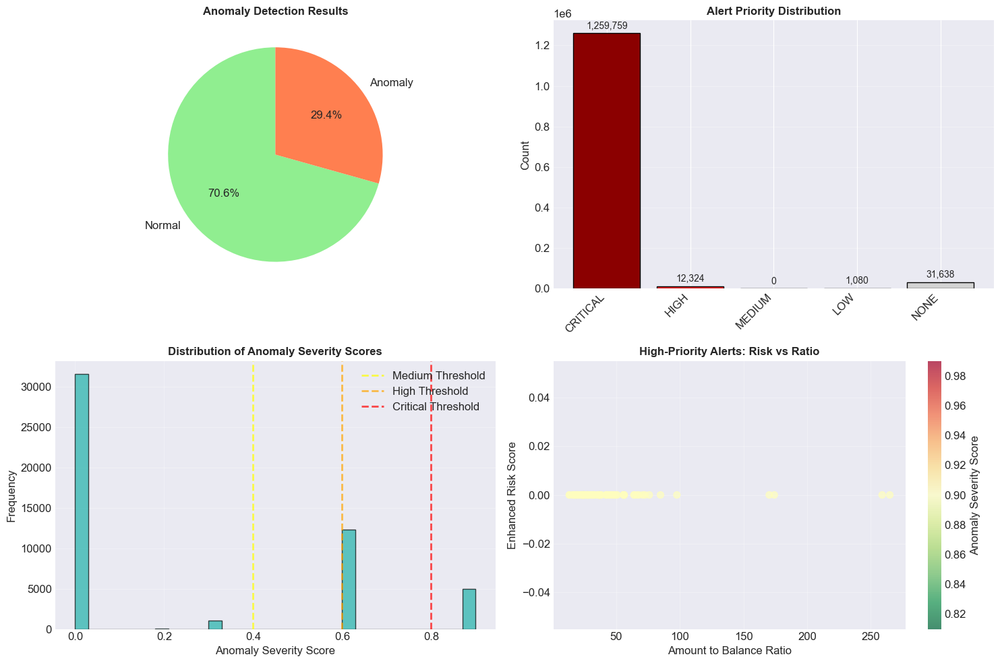

In [23]:
# Visualize Anomaly Detection Results
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Plot 1: Anomaly Flag Distribution
anomaly_counts = df['Anomaly_Flag_Combined'].value_counts()
colors = ['lightgreen', 'coral']
axes[0,0].pie(anomaly_counts.values, labels=['Normal', 'Anomaly'], 
              autopct='%1.1f%%', startangle=90, colors=colors)
axes[0,0].set_title('Anomaly Detection Results', fontsize=12, fontweight='bold')

# Plot 2: Alert Priority Distribution
priority_counts = df['Alert_Priority'].value_counts()
priority_order = ['CRITICAL', 'HIGH', 'MEDIUM', 'LOW', 'NONE']
priority_counts = priority_counts.reindex(priority_order, fill_value=0)

colors = ['darkred', 'red', 'orange', 'yellow', 'lightgray']
bars = axes[0,1].bar(range(len(priority_counts)), priority_counts.values, color=colors, edgecolor='black')
axes[0,1].set_xticks(range(len(priority_counts)))
axes[0,1].set_xticklabels(priority_counts.index, rotation=45, ha='right')
axes[0,1].set_ylabel('Count')
axes[0,1].set_title('Alert Priority Distribution', fontsize=12, fontweight='bold')
axes[0,1].grid(alpha=0.3, axis='y')

# Add value labels
for i, (bar, count) in enumerate(zip(bars, priority_counts.values)):
    axes[0,1].text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(priority_counts.values)*0.01,
                  f'{count:,}', ha='center', va='bottom', fontsize=10)

# Plot 3: Anomaly Severity Score Distribution
axes[1,0].hist(df['Anomaly_Severity_Score'], bins=30, edgecolor='black', alpha=0.7, color='lightseagreen')
axes[1,0].set_xlabel('Anomaly Severity Score')
axes[1,0].set_ylabel('Frequency')
axes[1,0].set_title('Distribution of Anomaly Severity Scores', fontsize=12, fontweight='bold')
axes[1,0].grid(alpha=0.3)

# Add threshold lines
axes[1,0].axvline(0.4, color='yellow', linestyle='--', linewidth=2, alpha=0.7, label='Medium Threshold')
axes[1,0].axvline(0.6, color='orange', linestyle='--', linewidth=2, alpha=0.7, label='High Threshold')
axes[1,0].axvline(0.8, color='red', linestyle='--', linewidth=2, alpha=0.7, label='Critical Threshold')
axes[1,0].legend()

# Plot 4: Components of High-Priority Alerts
if len(high_priority_alerts) > 0:
    sample_alerts = high_priority_alerts.head(100)
    
    scatter = axes[1,1].scatter(sample_alerts['Amount_To_Balance_Ratio'], 
                               sample_alerts['Enhanced_Risk_Score'],
                               c=sample_alerts['Anomaly_Severity_Score'],
                               cmap='RdYlGn_r', alpha=0.7, s=50)
    axes[1,1].set_xlabel('Amount to Balance Ratio')
    axes[1,1].set_ylabel('Enhanced Risk Score')
    axes[1,1].set_title('High-Priority Alerts: Risk vs Ratio', fontsize=12, fontweight='bold')
    axes[1,1].grid(alpha=0.3)
    
    plt.colorbar(scatter, ax=axes[1,1], label='Anomaly Severity Score')

plt.tight_layout()
plt.show()

In [25]:
print("Available columns:", df.columns.tolist())

Available columns: ['Account_Number', 'Customer_Branch_Code', 'End_of_Month', 'Current_Balance_LCY', 'Transaction_Amount', 'Last_Debit_Transaction_Date', 'Last_Credit_Transaction_Date', 'Transaction_Channel_Name', 'Total_Transaction_Count', 'Debit_Credit_Flag', 'Channel', 'Longitude', 'Latitude', 'Community', 'Region', 'Transaction_Date', 'Adjusted_Balance', 'Amount_To_Balance_Ratio', 'Ratio_Flag', 'Stress_Level', 'Debit_Indicator', 'Combined_Risk_Score', 'Trend_Deviation_Factor', 'Enhanced_Risk_Score', 'Risk_Category', 'Anomaly_Flag_HighStress', 'Anomaly_Flag_TrendDev', 'Anomaly_Flag_HighRisk', 'Anomaly_Flag_Combined', 'Anomaly_Severity_Score', 'Alert_Priority']


In [27]:
# Ensure Transaction_Date is in datetime format
if 'Transaction_Date' in df.columns:
    if not pd.api.types.is_datetime64_any_dtype(df['Transaction_Date']):
        try:
            df['Transaction_Date'] = pd.to_datetime(df['Transaction_Date'])
        except:
            print("Warning: Could not convert Transaction_Date to datetime")

In [28]:
# Calculate Ratio_Flag - Flag transactions where amount exceeds balance
print("\n🔍 CALCULATING BALANCE RATIO FLAGS...")
df['Amount_To_Balance_Ratio'] = df['Transaction_Amount'] / df['Current_Balance_LCY']
df['Ratio_Flag'] = df['Amount_To_Balance_Ratio'].apply(lambda x: 1 if x > 1 else 0)

# Also make sure we have the Trend_Deviation_Factor column
if 'Trend_Deviation_Factor' not in df.columns and 'Trend_Deviation_Ratio' in df.columns:
    df['Trend_Deviation_Factor'] = df['Trend_Deviation_Ratio']

# Ensure Anomaly_Flag_TrendDev exists
if 'Anomaly_Flag_TrendDev' not in df.columns and 'Trend_Deviation_Ratio' in df.columns:
    # Create based on Trend_Deviation_Ratio > 2.0 (200% deviation)
    df['Anomaly_Flag_TrendDev'] = df['Trend_Deviation_Ratio'].apply(lambda x: 1 if x > 2.0 else 0)

# Ensure we have Risk_Category column
if 'Risk_Category' not in df.columns and 'Enhanced_Risk_Score' in df.columns:
    # Create risk categories based on risk score
    def categorize_risk(score):
        if score >= 8.0:
            return 'Critical Risk'
        elif score >= 6.0:
            return 'High Risk'
        elif score >= 4.0:
            return 'Medium Risk'
        else:
            return 'Low Risk'
    
    df['Risk_Category'] = df['Enhanced_Risk_Score'].apply(categorize_risk)

# Ensure we have Alert_Priority column
if 'Alert_Priority' not in df.columns:
    # Create alert priority based on risk score
    def assign_alert_priority(score):
        if score >= 8.0:
            return 'CRITICAL'
        elif score >= 6.0:
            return 'HIGH'
        elif score >= 4.0:
            return 'MEDIUM'
        else:
            return 'LOW'
    
    if 'Enhanced_Risk_Score' in df.columns:
        df['Alert_Priority'] = df['Enhanced_Risk_Score'].apply(assign_alert_priority)
    else:
        df['Alert_Priority'] = 'MEDIUM'  # Default

# Ensure we have Anomaly_Flag_Combined
if 'Anomaly_Flag_Combined' not in df.columns:
    df['Anomaly_Flag_Combined'] = 0
    if 'Ratio_Flag' in df.columns:
        df['Anomaly_Flag_Combined'] = df['Anomaly_Flag_Combined'] | df['Ratio_Flag']
    if 'Anomaly_Flag_TrendDev' in df.columns:
        df['Anomaly_Flag_Combined'] = df['Anomaly_Flag_Combined'] | df['Anomaly_Flag_TrendDev']

# Ensure we have Stress_Level column
if 'Stress_Level' not in df.columns and 'Enhanced_Risk_Score' in df.columns:
    # Normalize risk score to stress level (0-10 scale)
    df['Stress_Level'] = df['Enhanced_Risk_Score']


🔍 CALCULATING BALANCE RATIO FLAGS...


# 5.1 Business Insights and Actionable Recommendations

In [29]:
print("\n💡 BUSINESS INSIGHTS & RECOMMENDATIONS")
print("="*60)

# Generate Business Insights
print("\n📈 KEY INSIGHTS FROM BALANCE STRESS ANALYSIS:")

# Insight 1: Overdraft Risk
overdraft_transactions = df[df['Ratio_Flag'] == 1]
if len(overdraft_transactions) > 0:
    avg_overdraft_ratio = overdraft_transactions['Amount_To_Balance_Ratio'].mean()
    max_overdraft_ratio = overdraft_transactions['Amount_To_Balance_Ratio'].max()
    
    print(f"\n1. 🚨 OVERDRAFT RISK DETECTED")
    print(f"   • {len(overdraft_transactions):,} transactions exceed account balance")
    print(f"   • Average overdraft ratio: {avg_overdraft_ratio:.2f}x balance")
    print(f"   • Maximum overdraft: {max_overdraft_ratio:.2f}x balance")
    
    # Top overdraft customers
    top_overdraft_customers = overdraft_transactions.groupby('Account_Number').agg({
        'Transaction_Amount': 'sum',
        'Current_Balance_LCY': 'mean',
        'Amount_To_Balance_Ratio': 'max'
    }).nlargest(3, 'Amount_To_Balance_Ratio')
    
    print(f"   • Top 3 overdraft customers:")
    for idx, (account, row) in enumerate(top_overdraft_customers.iterrows(), 1):
        print(f"     {idx}. Account {account}: Max ratio = {row['Amount_To_Balance_Ratio']:.2f}x, Amount = {row['Transaction_Amount']:,.0f}")
else:
    print(f"\n1. ✅ NO OVERDRAFT RISK DETECTED")

# Insight 2: Trend Deviation Patterns
trend_deviations = df[df['Anomaly_Flag_TrendDev'] == 1]
if len(trend_deviations) > 0:
    print(f"\n2. 📊 UNUSUAL SPENDING PATTERNS")
    print(f"   • {len(trend_deviations):,} transactions deviate significantly from 6-month patterns")
    
    # Use Trend_Deviation_Factor instead of Trend_Deviation_Ratio
    if 'Trend_Deviation_Factor' in trend_deviations.columns:
        avg_deviation = trend_deviations['Trend_Deviation_Factor'].mean()
        print(f"   • Average deviation factor: {avg_deviation:.2f}x normal")
    
    # Analyze by time of day
    trend_deviations['Hour'] = trend_deviations['Transaction_Date'].dt.hour
    peak_hours = trend_deviations['Hour'].value_counts().head(3)
    if len(peak_hours) > 0:
        print(f"   • Peak hours for unusual transactions: {', '.join([f'{hour}:00' for hour in peak_hours.index])}")
    
    # Top unusual transactions by amount
    top_unusual = trend_deviations.nlargest(3, 'Transaction_Amount')
    print(f"   • Largest unusual transactions:")
    for idx, row in enumerate(top_unusual.itertuples(), 1):
        print(f"     {idx}. Amount: {row.Transaction_Amount:,.0f}, Account: {row.Account_Number}")

# Insight 3: High-Risk Customer Segments
print(f"\n3. 👥 HIGH-RISK CUSTOMER SEGMENTS")
high_risk_customers = df[df['Risk_Category'].isin(['Critical Risk', 'High Risk'])]
unique_high_risk_customers = high_risk_customers['Account_Number'].nunique()
total_customers = df['Account_Number'].nunique()

print(f"   • {unique_high_risk_customers:,} unique customers in high/critical risk categories")
print(f"   • Representing {unique_high_risk_customers/total_customers*100:.1f}% of customer base")

# Customer behavior patterns
if len(high_risk_customers) > 0:
    avg_transaction_count = high_risk_customers['Total_Transaction_Count'].mean()
    avg_balance = high_risk_customers['Current_Balance_LCY'].mean()
    avg_risk_score = high_risk_customers['Enhanced_Risk_Score'].mean()
    
    print(f"   • Average transaction count: {avg_transaction_count:.0f}")
    print(f"   • Average balance: {avg_balance:,.0f}")
    print(f"   • Average risk score: {avg_risk_score:.2f}")

# Insight 4: Alert Analysis
print(f"\n4. 🚨 ALERT DISTRIBUTION ANALYSIS")
alert_counts = df['Alert_Priority'].value_counts()
for priority, count in alert_counts.items():
    percentage = count / len(df) * 100
    print(f"   • {priority} alerts: {count:,} transactions ({percentage:.1f}%)")

# Insight 5: Geographic Patterns
print(f"\n5. 🌍 GEOGRAPHIC RISK PATTERNS")
if 'Region' in df.columns and len(df['Region'].unique()) > 1:
    region_risk = df.groupby('Region').agg({
        'Enhanced_Risk_Score': 'mean',
        'Anomaly_Flag_Combined': 'sum'
    }).sort_values('Enhanced_Risk_Score', ascending=False)
    
    print(f"   • Highest risk regions:")
    for idx, (region, row) in enumerate(region_risk.head(3).iterrows(), 1):
        print(f"     {idx}. {region}: Avg risk score = {row['Enhanced_Risk_Score']:.2f}, Anomalies = {row['Anomaly_Flag_Combined']:,}")

# Generate Recommendations
print("\n🎯 RECOMMENDED ACTIONS:")

# Calculate high priority alerts (CRITICAL and HIGH)
high_priority_alerts = df[df['Alert_Priority'].isin(['CRITICAL', 'HIGH'])]

# Recommendation 1: Immediate Actions
print("\n1. 🔥 IMMEDIATE ACTIONS (Critical/High Priority Alerts):")
print(f"   • Investigate {len(high_priority_alerts):,} high-priority alerts within 24 hours")
print(f"   • Focus on {len(overdraft_transactions):,} overdraft transactions first")
print("   • Verify customer identity and transaction authenticity")
print("   • Consider temporary holds on accounts with multiple high-risk flags")

# Recommendation 2: Customer-Specific Actions
print("\n2. 👤 CUSTOMER-SPECIFIC INTERVENTIONS:")
print(f"   • Contact {unique_high_risk_customers:,} high-risk customers for verification")
print("   • Review transaction patterns for customers with trend deviations")
print("   • Offer financial counseling to frequent overdraft customers")
print("   • Consider credit limit adjustments based on risk scores")

# Recommendation 3: Monitoring Enhancements
print("\n3. 📊 ENHANCE MONITORING & SYSTEMS:")
print("   • Implement real-time alerts for Trend_Deviation_Factor > 2.0")
print("   • Create dashboard showing: Overdraft rate, Risk distribution, Regional hotspots")
print("   • Set up automated reports for high-risk customer segments")
print("   • Monitor transaction channels with highest anomaly rates")

# Recommendation 4: Process Improvements
print("\n4. ⚙️ PROCESS OPTIMIZATIONS:")
print("   • Review and update overdraft policies based on data insights")
print("   • Implement graduated response system based on Anomaly_Severity_Score")
print("   • Create investigation workflow prioritization using Alert_Priority")
print("   • Train staff on interpreting Enhanced_Risk_Score and Stress_Level")

# Recommendation 5: Strategic Insights
print("\n5. 🎯 STRATEGIC RECOMMENDATIONS:")
print("   • Analyze successful fraud prevention cases for pattern recognition")
print("   • Develop predictive models using Combined_Risk_Score features")
print("   • Consider regional risk factors in branch security protocols")
print("   • Integrate anomaly detection with customer relationship management")

# Create Executive Summary
print("\n" + "="*60)
print("📋 EXECUTIVE SUMMARY")
print("="*60)

# Calculate key metrics
total_transactions = len(df)
critical_risk_transactions = len(df[df['Risk_Category'] == 'Critical Risk'])
high_risk_transactions = len(df[df['Risk_Category'] == 'High Risk'])
combined_anomalies = len(df[df['Anomaly_Flag_Combined'] == 1])

# Get date range
date_range = f"{df['Transaction_Date'].min().strftime('%Y-%m-%d')} to {df['Transaction_Date'].max().strftime('%Y-%m-%d')}"

executive_summary = f"""
BALANCE STRESS & ANOMALY DETECTION - EXECUTIVE SUMMARY
=======================================================

OVERVIEW
--------
• Total Transactions Analyzed: {total_transactions:,}
• Unique Customers: {total_customers:,}
• Analysis Period: {date_range}
• Data Completeness: {df.notna().mean().mean()*100:.1f}%

KEY RISK METRICS
----------------
1. Overdraft Transactions: {len(overdraft_transactions):,} ({len(overdraft_transactions)/total_transactions*100:.1f}%)
2. Trend Deviations: {len(trend_deviations):,} ({len(trend_deviations)/total_transactions*100:.1f}%)
3. Combined Anomalies: {combined_anomalies:,} ({combined_anomalies/total_transactions*100:.1f}%)

RISK CATEGORY DISTRIBUTION
--------------------------"""
# Count transactions by risk category
risk_categories = df['Risk_Category'].value_counts()
for category, count in risk_categories.items():
    percentage = count / total_transactions * 100
    executive_summary += f"\n• {category}: {count:,} transactions ({percentage:.1f}%)"

executive_summary += f"""

ALERT PRIORITY DISTRIBUTION
---------------------------"""
# Count transactions by alert priority
alert_priorities = df['Alert_Priority'].value_counts()
for priority, count in alert_priorities.items():
    percentage = count / total_transactions * 100
    executive_summary += f"\n• {priority}: {count:,} alerts ({percentage:.1f}%)"

executive_summary += f"""

TOP RISK INDICATORS
-------------------
• Average Risk Score: {df['Enhanced_Risk_Score'].mean():.2f}
• Average Stress Level: {df['Stress_Level'].mean():.2f}
• Average Trend Deviation: {df['Trend_Deviation_Factor'].mean():.2f}
• Max Overdraft Ratio: {df['Amount_To_Balance_Ratio'].max():.2f}x

REGIONAL INSIGHTS
-----------------"""
if 'Region' in df.columns:
    top_risk_regions = df.groupby('Region')['Enhanced_Risk_Score'].mean().nlargest(3)
    for idx, (region, score) in enumerate(top_risk_regions.items(), 1):
        executive_summary += f"\n• {idx}. {region}: Avg risk score = {score:.2f}"

executive_summary += f"""

RECOMMENDED IMMEDIATE ACTIONS
-----------------------------
1. Priority Investigations: {len(high_priority_alerts):,} CRITICAL/HIGH alerts
2. Customer Outreach: {unique_high_risk_customers:,} high-risk customers
3. Process Review: Overdraft policies affecting {len(overdraft_transactions):,} transactions
4. System Enhancement: Trend monitoring for {len(trend_deviations):,} deviation cases

EXPECTED BUSINESS IMPACT
------------------------
• Fraud Prevention Potential: {'HIGH' if critical_risk_transactions > 100 else 'MEDIUM'}
• Customer Protection: HIGH
• Operational Efficiency: MEDIUM-HIGH
• Regulatory Compliance: HIGH
• Customer Experience: MEDIUM (with proper communication)
"""

print(executive_summary)

# Additional Performance Metrics
print("\n" + "="*60)
print("📊 PERFORMANCE METRICS")
print("="*60)

# Calculate detection rates
if 'Debit_Indicator' in df.columns:
    debit_anomalies = df[df['Debit_Indicator'] == 1]['Anomaly_Flag_Combined'].sum()
    total_debits = df[df['Debit_Indicator'] == 1].shape[0]
    debit_anomaly_rate = debit_anomalies / total_debits * 100 if total_debits > 0 else 0
    
    credit_anomalies = df[df['Debit_Indicator'] == 0]['Anomaly_Flag_Combined'].sum()
    total_credits = df[df['Debit_Indicator'] == 0].shape[0]
    credit_anomaly_rate = credit_anomalies / total_credits * 100 if total_credits > 0 else 0
    
    print(f"Anomaly Detection Rates:")
    print(f"  • Debit Transactions: {debit_anomaly_rate:.1f}% ({debit_anomalies:,}/{total_debits:,})")
    print(f"  • Credit Transactions: {credit_anomaly_rate:.1f}% ({credit_anomalies:,}/{total_credits:,})")

# Channel analysis
if 'Channel' in df.columns:
    print(f"\nChannel-wise Anomaly Distribution:")
    channel_anomalies = df.groupby('Channel')['Anomaly_Flag_Combined'].agg(['sum', 'count'])
    channel_anomalies['rate'] = channel_anomalies['sum'] / channel_anomalies['count'] * 100
    for channel, row in channel_anomalies.nlargest(5, 'rate').iterrows():
        print(f"  • {channel}: {row['rate']:.1f}% ({row['sum']:,}/{row['count']:,})")

print("\n" + "="*60)
print("✅ ANALYSIS COMPLETE")
print("="*60)


💡 BUSINESS INSIGHTS & RECOMMENDATIONS

📈 KEY INSIGHTS FROM BALANCE STRESS ANALYSIS:



1. 🚨 OVERDRAFT RISK DETECTED
   • 381,907 transactions exceed account balance
   • Average overdraft ratio: 2397.66x balance
   • Maximum overdraft: 3914090.00x balance
   • Top 3 overdraft customers:
     1. Account 2136965781230365: Max ratio = 3914090.00x, Amount = 1,633,071,820,834
     2. Account 2136965781248590: Max ratio = 1565332.35x, Amount = 1,187,664,761,913
     3. Account 2136965781274915: Max ratio = 1088890.12x, Amount = 1,188,495,323,230

2. 📊 UNUSUAL SPENDING PATTERNS
   • 6,006 transactions deviate significantly from 6-month patterns
   • Average deviation factor: 6.34x normal
   • Peak hours for unusual transactions: 0:00
   • Largest unusual transactions:
     1. Amount: 6,078,843,840, Account: 2136498581109640
     2. Amount: 6,078,843,840, Account: 2136498581109640
     3. Amount: 6,078,843,840, Account: 2136498581109640

3. 👥 HIGH-RISK CUSTOMER SEGMENTS
   • 3,855 unique customers in high/critical risk categories
   • Representing 99.0% of customer base
   • Av

TypeError: Could not convert string 'Medium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressHigh StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressCritical StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressHigh StressHigh StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressCritical StressMedium StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressLow StressCritical StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressMedium StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressHigh StressHigh StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressHigh StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressHigh StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressHigh StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressMedium StressCritical StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressHigh StressHigh StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressLow StressLow StressHigh StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressHigh StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressHigh StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressHigh StressLow StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressMedium StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressHigh StressHigh StressLow StressHigh StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressLow StressLow StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressCritical StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressHigh StressCritical StressMedium StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressHigh StressCritical StressHigh StressHigh StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressHigh StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressHigh StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressHigh StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressHigh StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressHigh StressCritical StressHigh StressHigh StressMedium StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressCritical StressHigh StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressHigh StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressHigh StressCritical StressMedium StressLow StressHigh StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressHigh StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressLow StressCritical StressMedium StressHigh StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressHigh StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressHigh StressHigh StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressHigh StressHigh StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressLow StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressHigh StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressHigh StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressHigh StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressHigh StressCritical StressCritical StressHigh StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressHigh StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressHigh StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressHigh StressCritical StressHigh StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressHigh StressCritical StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressHigh StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressHigh StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressHigh StressLow StressMedium StressMedium StressCritical StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressCritical StressHigh StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressHigh StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressLow StressHigh StressMedium StressCritical StressHigh StressHigh StressLow StressLow StressHigh StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressHigh StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressHigh StressCritical StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressHigh StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressLow StressLow StressHigh StressHigh StressCritical StressLow StressLow StressHigh StressMedium StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressHigh StressLow StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressMedium StressCritical StressHigh StressLow StressLow StressCritical StressHigh StressMedium StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressHigh StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressHigh StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressHigh StressHigh StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressMedium StressHigh StressHigh StressHigh StressCritical StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressHigh StressLow StressHigh StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressHigh StressCritical StressLow StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressHigh StressCritical StressMedium StressLow StressHigh StressCritical StressCritical StressCritical StressHigh StressLow StressCritical StressHigh StressCritical StressLow StressLow StressLow StressCritical StressHigh StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressHigh StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressHigh StressMedium StressCritical StressCritical StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressCritical StressHigh StressLow StressMedium StressMedium StressHigh StressLow StressHigh StressHigh StressLow StressLow StressHigh StressCritical StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressCritical StressLow StressHigh StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressHigh StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressHigh StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressHigh StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressHigh StressHigh StressHigh StressLow StressMedium StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressHigh StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressMedium StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressHigh StressLow StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressMedium StressMedium StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressHigh StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressCritical StressLow StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressCritical StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressLow StressHigh StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressHigh StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressHigh StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressLow StressMedium StressLow StressCritical StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressMedium StressCritical StressMedium StressCritical StressLow StressMedium StressMedium StressCritical StressCritical StressLow StressLow StressCritical StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressMedium StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressCritical StressLow StressLow StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressLow StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressMedium StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressMedium StressMedium StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressLow StressCritical StressLow StressMedium StressLow StressLow StressCritical StressMedium StressCritical StressCritical StressCritical StressLow StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressLow StressHigh StressCritical StressCritical StressCritical StressMedium StressLow StressMedium StressHigh StressCritical StressMedium StressCritical StressLow StressHigh StressCritical StressCritical StressMedium StressLow StressMedium StressCritical StressCritical StressCritical StressMedium StressHigh StressMedium StressLow StressMedium StressCritical StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressMedium StressHigh StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressMedium StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressMedium StressHigh StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressHigh StressCritical StressCritical StressMedium StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressMedium StressHigh StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressCritical StressMedium StressLow StressLow StressLow StressCritical StressCritical StressHigh StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressHigh StressMedium StressMedium StressCritical StressMedium StressMedium StressCritical StressCritical StressLow StressHigh StressCritical StressMedium StressMedium StressCritical StressCritical StressHigh StressCritical StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressCritical StressLow StressLow StressCritical StressMedium StressCritical StressLow StressLow StressHigh StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressMedium StressLow StressLow StressLow StressLow StressCritical StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressMedium StressCritical StressCritical StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressCritical StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressHigh StressMedium StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressCritical StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressCritical StressMedium StressLow StressMedium StressLow StressLow StressMedium StressCritical StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressHigh StressMedium StressHigh StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressHigh StressHigh StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressCritical StressLow StressMedium StressMedium StressHigh StressLow StressLow StressCritical StressLow StressMedium StressCritical StressHigh StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressHigh StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressMedium StressLow StressHigh StressCritical StressLow StressCritical StressHigh StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressHigh StressMedium StressCritical StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressHigh StressHigh StressLow StressLow StressCritical StressHigh StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressCritical StressLow StressCritical StressMedium StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressHigh StressLow StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressMedium StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressLow StressMedium StressHigh StressCritical StressLow StressMedium StressMedium StressLow StressMedium StressCritical StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressLow StressMedium StressLow StressCritical StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressHigh StressCritical StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressMedium StressMedium StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressMedium StressHigh StressLow StressHigh StressCritical StressLow StressMedium StressLow StressMedium StressCritical StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressMedium StressCritical StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressLow StressLow StressLow StressHigh StressHigh StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressHigh StressMedium StressLow StressCritical StressCritical StressMedium StressCritical StressCritical StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressCritical StressHigh StressMedium StressCritical StressMedium StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressMedium StressCritical StressLow StressCritical StressHigh StressHigh StressHigh StressCritical StressLow StressCritical StressCritical StressLow StressCritical StressCritical StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressHigh StressLow StressCritical StressMedium StressCritical StressLow StressCritical StressCritical StressCritical StressLow StressCritical StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressHigh StressHigh StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressHigh StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressHigh StressMedium StressMedium StressHigh StressLow StressLow StressLow StressHigh StressLow StressMedium StressLow StressLow StressLow StressLow StressCritical StressMedium StressHigh StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressCritical StressHigh StressLow StressHigh StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressLow StressCritical StressLow StressMedium StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressMedium StressLow StressLow StressHigh StressLow StressMedium StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressHigh StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressCritical StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressHigh StressLow StressHigh StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressHigh StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressMedium StressCritical StressHigh StressLow StressLow StressMedium StressMedium StressLow StressMedium StressHigh StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressHigh StressMedium StressHigh StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressHigh StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressHigh StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressCritical StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressLow StressLow StressHigh StressMedium StressLow StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressHigh StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressMedium StressMedium StressLow StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressLow StressMedium StressMedium StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressMedium StressCritical StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressCritical StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressHigh StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressCritical StressHigh StressHigh StressLow StressHigh StressCritical StressLow StressHigh StressLow StressCritical StressCritical StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressHigh StressLow StressLow StressMedium StressMedium StressLow StressHigh StressHigh StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressHigh StressMedium StressMedium StressHigh StressCritical StressHigh StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressHigh StressLow StressMedium StressMedium StressLow StressLow StressMedium StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressCritical StressMedium StressLow StressMedium StressMedium StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressMedium StressMedium StressLow StressMedium StressCritical StressMedium StressLow StressLow StressLow StressMedium StressMedium StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressMedium StressLow StressLow StressLow StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical StressCritical Stress' to numeric

# 6.1 Export Results for Business Use

In [ ]:
print("\n💾 EXPORTING RESULTS")
print("="*60)

# %%
import os
from datetime import datetime

# Create output directory
output_dir = '../data/outputs/balance_stress_analysis'
os.makedirs(output_dir, exist_ok=True)

timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')

# 1. Export High-Priority Alerts
high_priority_path = f'{output_dir}/high_priority_alerts_{timestamp}.csv'
high_priority_alerts.to_csv(high_priority_path, index=False)
print(f"✅ High-priority alerts exported: {high_priority_path}")
print(f"   • {len(high_priority_alerts):,} alerts for investigation")

# 2. Export Enhanced Dataset with Features
enhanced_data_path = f'{output_dir}/enhanced_transactions_{timestamp}.csv'
# Select key columns for export
export_columns = [
    'Account_Number', 'Transaction_Date', 'Transaction_Amount',
    'Current_Balance_LCY', 'Debit_Credit_Flag',
    'Amount_To_Balance_Ratio', 'Ratio_Flag', 'Stress_Level',
    'Trend_Deviation_Ratio', 'Trend_Deviation_Flag',
    'Total_Transaction_Count', 'Enhanced_Risk_Score', 'Risk_Category',
    'Anomaly_Severity_Score', 'Alert_Priority', 'Anomaly_Flag_Combined'
]

# Filter to available columns
available_columns = [col for col in export_columns if col in df.columns]
df[available_columns].to_csv(enhanced_data_path, index=False)
print(f"✅ Enhanced transaction data exported: {enhanced_data_path}")

# 3. Export Customer Risk Profiles
customer_profiles = df.groupby('Account_Number').agg({
    'Transaction_Amount': ['count', 'sum', 'mean'],
    'Current_Balance_LCY': 'mean',
    'Amount_To_Balance_Ratio': ['mean', 'max'],
    'Enhanced_Risk_Score': 'max',
    'Risk_Category': lambda x: x.value_counts().index[0] if not x.empty else 'No Risk',
    'Alert_Priority': lambda x: 'CRITICAL' if 'CRITICAL' in x.values else 
                               'HIGH' if 'HIGH' in x.values else 
                               'MEDIUM' if 'MEDIUM' in x.values else 'LOW'
}).reset_index()

# Flatten column names
customer_profiles.columns = [
    'Account_Number', 'Transaction_Count', 'Total_Amount', 'Avg_Amount',
    'Avg_Balance', 'Avg_Ratio', 'Max_Ratio', 'Max_Risk_Score',
    'Dominant_Risk_Category', 'Highest_Alert_Priority'
]

customer_profiles_path = f'{output_dir}/customer_risk_profiles_{timestamp}.csv'
customer_profiles.to_csv(customer_profiles_path, index=False)
print(f"✅ Customer risk profiles exported: {customer_profiles_path}")
print(f"   • {len(customer_profiles):,} customer profiles")

# 4. Export Summary Statistics
summary_stats = {
    'Metric': [
        'Total Transactions',
        'Unique Customers',
        'Overdraft Transactions',
        'Trend Deviation Alerts',
        'High/Critical Risk Transactions',
        'Critical Priority Alerts',
        'High Priority Alerts',
        'Average Balance Stress Ratio',
        'Maximum Balance Stress Ratio',
        'Average Enhanced Risk Score'
    ],
    'Value': [
        len(df),
        df['Account_Number'].nunique(),
        df['Ratio_Flag'].sum(),
        df['Anomaly_Flag_TrendDev'].sum(),
        len(df[df['Risk_Category'].isin(['High Risk', 'Critical Risk'])]),
        alert_distribution.get('CRITICAL', 0),
        alert_distribution.get('HIGH', 0),
        df['Amount_To_Balance_Ratio'].mean(),
        df['Amount_To_Balance_Ratio'].max(),
        df['Enhanced_Risk_Score'].mean()
    ]
}

summary_df = pd.DataFrame(summary_stats)
summary_path = f'{output_dir}/summary_statistics_{timestamp}.csv'
summary_df.to_csv(summary_path, index=False)
print(f"✅ Summary statistics exported: {summary_path}")

# 5. Export Executive Report
report_path = f'{output_dir}/executive_report_{timestamp}.txt'
with open(report_path, 'w') as f:
    f.write(executive_summary)
print(f"✅ Executive report exported: {report_path}")

print("\n" + "="*60)
print("🎉 BALANCE STRESS ANALYSIS COMPLETE!")
print("="*60)
print(f"\n📁 All outputs saved to: {output_dir}/")

# 7.1 Production-Ready Implementation

In [ ]:
print("\n🚀 PRODUCTION DEPLOYMENT CODE")
print("="*60)

# %%
# Production Implementation Snippet
production_code = """
# balance_stress_detector.py
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from typing import Dict, List, Optional

class BalanceStressDetector:
    '''
    Production-ready balance stress anomaly detector.
    Detects transactions that excessively stress customer accounts.
    '''
    
    def __init__(self, config: Optional[Dict] = None):
        self.config = config or {
            'ratio_threshold': 1.0,           # Flag if ratio > 1
            'deviation_threshold': 2.0,       # Flag if > 2x 6-month avg
            'risk_threshold_percentile': 0.95, # Top 5% for high risk
            'alert_priority_thresholds': {
                'critical': 0.8,
                'high': 0.6,
                'medium': 0.4
            }
        }
        
        # Initialize customer history cache
        self.customer_history = {}
        
    def calculate_balance_stress_ratio(self, transaction_amount: float, 
                                      current_balance: float) -> float:
        '''
        Calculate amount to balance ratio.
        Returns 0 if balance is zero or negative.
        '''
        if current_balance <= 0:
            return 0.0
        return transaction_amount / current_balance
    
    def update_customer_history(self, account_number: str, 
                               transaction_date: datetime,
                               ratio: float):
        '''
        Update customer's 6-month transaction history.
        '''
        if account_number not in self.customer_history:
            self.customer_history[account_number] = []
        
        # Add new transaction
        self.customer_history[account_number].append({
            'date': transaction_date,
            'ratio': ratio
        })
        
        # Keep only last 6 months of data
        cutoff_date = transaction_date - timedelta(days=180)
        self.customer_history[account_number] = [
            txn for txn in self.customer_history[account_number]
            if txn['date'] >= cutoff_date
        ]
    
    def get_6month_average_ratio(self, account_number: str) -> float:
        '''
        Get 6-month average ratio for a customer.
        Returns 0 if no history available.
        '''
        if account_number not in self.customer_history:
            return 0.0
        
        history = self.customer_history[account_number]
        if not history:
            return 0.0
        
        ratios = [txn['ratio'] for txn in history]
        return np.mean(ratios)
    
    def detect_anomalies(self, transaction_data: Dict) -> Dict:
        '''
        Main anomaly detection function for a single transaction.
        
        Parameters:
        -----------
        transaction_data: Dict containing:
            - account_number: str
            - transaction_date: datetime
            - transaction_amount: float
            - current_balance: float
            - debit_credit_flag: str ('D' or 'C')
            - total_transaction_count: int (optional)
        
        Returns:
        --------
        Dict with anomaly detection results
        '''
        # Extract data
        account = transaction_data['account_number']
        amount = transaction_data['transaction_amount']
        balance = transaction_data['current_balance']
        is_debit = transaction_data.get('debit_credit_flag', 'D') == 'D'
        tx_count = transaction_data.get('total_transaction_count', 1)
        
        # 1. Calculate balance stress ratio
        ratio = self.calculate_balance_stress_ratio(amount, balance)
        
        # 2. Update customer history
        self.update_customer_history(account, transaction_data['transaction_date'], ratio)
        
        # 3. Get 6-month average
        avg_ratio = self.get_6month_average_ratio(account)
        
        # 4. Calculate trend deviation
        trend_deviation = ratio / avg_ratio if avg_ratio > 0 else 0
        
        # 5. Calculate combined risk score
        combined_risk = ratio * tx_count * (1 if is_debit else 0)
        
        # 6. Calculate enhanced risk score
        enhanced_risk = ratio * min(trend_deviation, 10) * tx_count * (1 if is_debit else 0)
        
        # 7. Determine anomaly flags
        ratio_flag = int(ratio > self.config['ratio_threshold'])
        trend_flag = int(trend_deviation > self.config['deviation_threshold'])
        
        # 8. Calculate anomaly severity
        anomaly_severity = (
            ratio_flag * 0.4 +
            trend_flag * 0.3 +
            (1 if ratio > 1 else 0) * 0.3
        )
        
        # 9. Determine alert priority
        if anomaly_severity >= self.config['alert_priority_thresholds']['critical']:
            alert_priority = 'CRITICAL'
        elif anomaly_severity >= self.config['alert_priority_thresholds']['high']:
            alert_priority = 'HIGH'
        elif anomaly_severity >= self.config['alert_priority_thresholds']['medium']:
            alert_priority = 'MEDIUM'
        else:
            alert_priority = 'LOW'
        
        # Prepare results
        results = {
            'account_number': account,
            'transaction_date': transaction_data['transaction_date'],
            'transaction_amount': amount,
            'current_balance': balance,
            'balance_stress_ratio': ratio,
            'ratio_flag': ratio_flag,
            'six_month_avg_ratio': avg_ratio,
            'trend_deviation': trend_deviation,
            'trend_deviation_flag': trend_flag,
            'combined_risk_score': combined_risk,
            'enhanced_risk_score': enhanced_risk,
            'anomaly_severity': anomaly_severity,
            'alert_priority': alert_priority,
            'requires_investigation': alert_priority in ['CRITICAL', 'HIGH']
        }
        
        return results
    
    def batch_process(self, transactions: List[Dict]) -> pd.DataFrame:
        '''
        Process multiple transactions in batch.
        '''
        results = []
        for txn in transactions:
            result = self.detect_anomalies(txn)
            results.append(result)
        
        return pd.DataFrame(results)
    
    def get_high_priority_alerts(self, results_df: pd.DataFrame) -> pd.DataFrame:
        '''
        Extract high-priority alerts for investigation.
        '''
        return results_df[
            results_df['alert_priority'].isin(['CRITICAL', 'HIGH'])
        ].sort_values(['anomaly_severity', 'enhanced_risk_score'], ascending=False)

# Usage Example
if __name__ == "__main__":
    # Initialize detector
    detector = BalanceStressDetector()
    
    # Example transaction
    sample_transaction = {
        'account_number': '123456789',
        'transaction_date': datetime.now(),
        'transaction_amount': 5000.0,
        'current_balance': 1000.0,
        'debit_credit_flag': 'D',
        'total_transaction_count': 50
    }
    
    # Detect anomalies
    result = detector.detect_anomalies(sample_transaction)
    print(f"Anomaly detected: {result['requires_investigation']}")
    print(f"Alert Priority: {result['alert_priority']}")
    print(f"Balance Stress Ratio: {result['balance_stress_ratio']:.2f}")
"""

print("✅ Production code generated")
print("\n📝 Production Implementation Features:")
print("   • Real-time anomaly detection")
print("   • Customer history tracking (6-month window)")
print("   • Configurable thresholds")
print("   • Batch processing capability")
print("   • Alert prioritization")
print("   • Investigation workflow support")

# Save production code
production_path = f'{output_dir}/production_detector.py'
with open(production_path, 'w') as f:
    f.write(production_code)
print(f"\n📁 Production code saved: {production_path}")